<a href="https://colab.research.google.com/github/Kripa-Shankar/Plastic-Detection-in-River/blob/main/plasticDet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [16]:
import os
import pandas as pd
from PIL import Image
from pathlib import Path
from ultralytics import YOLO

# Set the path to the directory containing the images to predict
path = "/content/Plastic_Detect/Predict"

# Load the YOLO model
model = YOLO('/content/Plastic_Detect/YOLO_Custom_v8m.pt')

# Iterate through the files in the specified directory
for i, file_name in enumerate(os.listdir(path)):
    file_path = os.path.join(path, file_name)

    # Make a prediction using the YOLO model
    model.predict(source=file_path, save=True, conf=0.37)

    # Open the image using PIL
    image = Image.open(file_path)

    # Extract GPS information from the image's EXIF data
    exif_data = {PIL.ExifTags.TAGS[k]: v for k, v in image._getexif().items() if k in PIL.ExifTags.TAGS}
    gps_info = exif_data.get('GPSInfo', None)

    if gps_info is not None:
        # Extract latitude and longitude information from GPS data
        ns = gps_info[2]
        ew = gps_info[4]
        latitude = (float(ns[0] * 3600 + ns[1] * 60 + ns[2])) / 3600000
        longitude = (float(ew[0] * 3600 + ew[1] * 60 + ew[2])) / 3600000

        # Perform further operations with latitude and longitude if needed
        # For example, update a DataFrame with this information

        # df.loc[i, 'Geo_Tag_URL'] = f"{latitude}°N {longitude}°E"
        # df.to_csv("/content/Plastic_Detect/submit.csv", index=False)



image 1/1 /content/Plastic_Detect/Predict/DJI_0080.jpg: 480x640 18 0s, 1148.0ms
Speed: 4.2ms preprocess, 1148.0ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2

image 1/1 /content/Plastic_Detect/Predict/DJI_0268.jpg: 480x640 26 0s, 1869.7ms
Speed: 4.9ms preprocess, 1869.7ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2

image 1/1 /content/Plastic_Detect/Predict/DJI_0416.jpg: 480x640 4 0s, 1083.9ms
Speed: 4.8ms preprocess, 1083.9ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2

image 1/1 /content/Plastic_Detect/Predict/DJI_0185.jpg: 480x640 18 0s, 1133.1ms
Speed: 3.6ms preprocess, 1133.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict2

image 1/1 /content/Plastic_Detect/Predict/DJI_0023.jpg: 480x640 16 0s, 1130.6ms
Speed: 4.0ms preprocess, 1130.6ms inference, 1.7

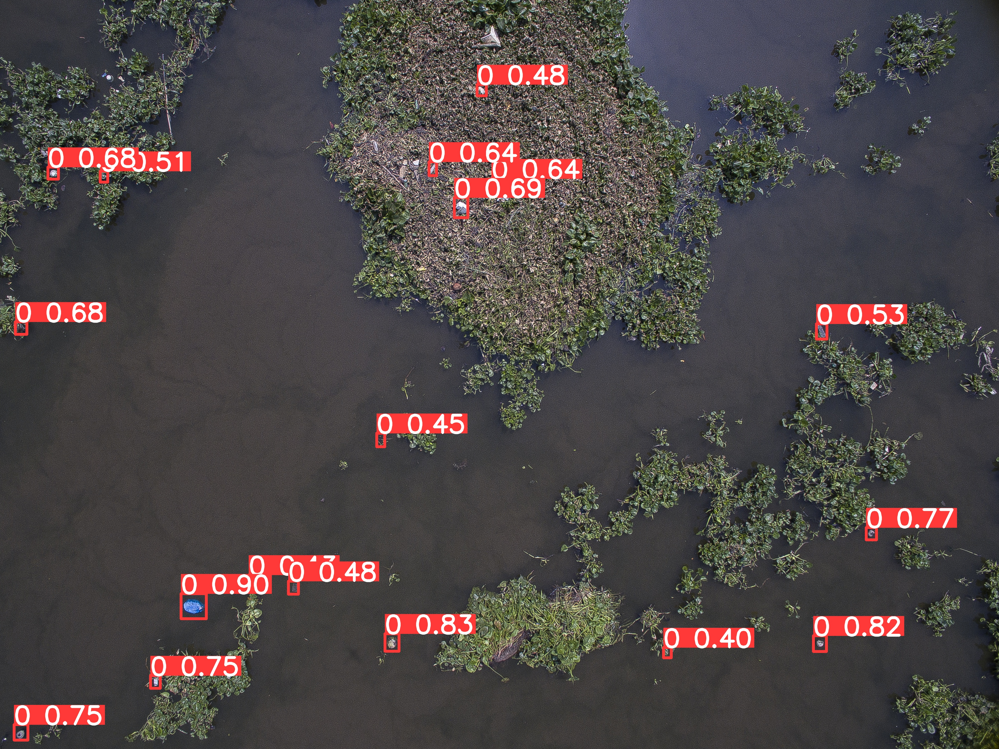

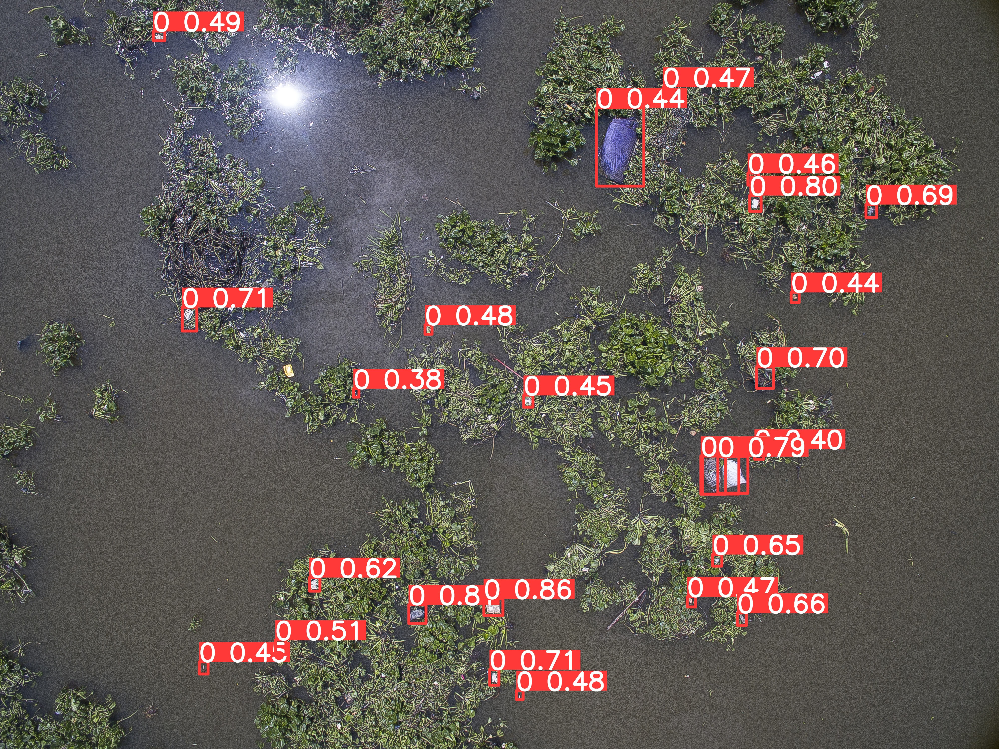

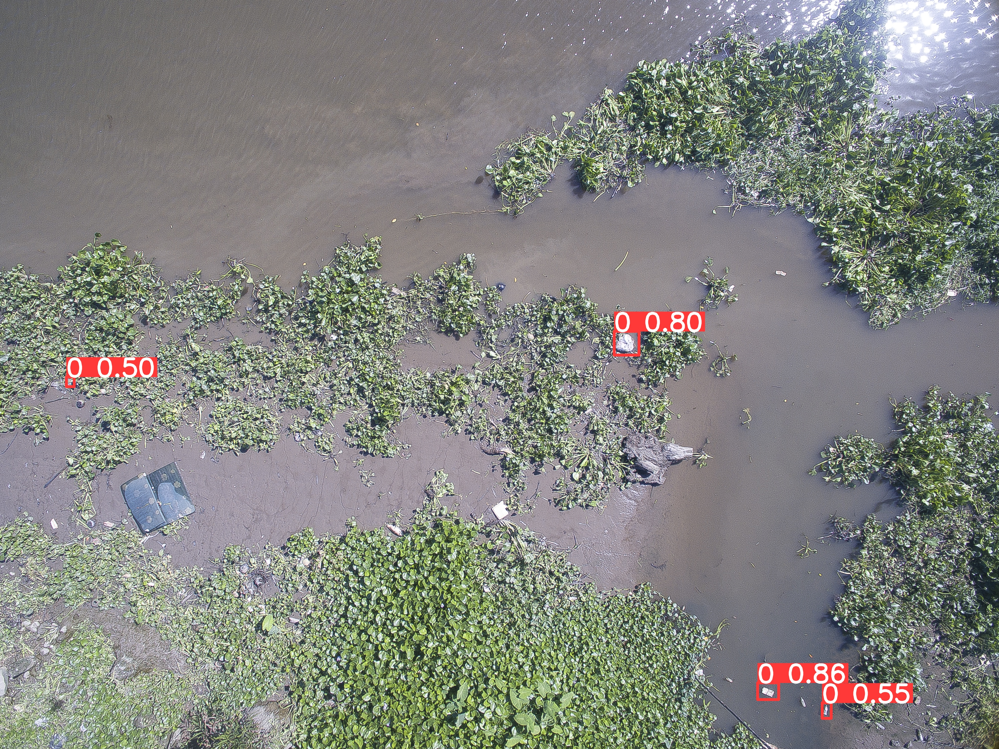

In [17]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg')[:3]:
      display(Image(filename=image_path, width=600))
      print("\n")

In [ ]:
pip install -r /content/Plastic_Detect/requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 644.5/644.5 kB 8.7 MB/s eta 0:00:00
